## *Name: Fiyinfoluwa Seinde-Olaniyi*
Here I chose the Cat/Dog dataset, I ran into hiccups when it came to breaking up the notebook in the homework instruction, hence why it's all in one. Below is a content list for easier navigation.
# Cats & Dogs Classification - Transfer Learning
# **Introduction**

**Task**
---

To build a model that can classify between a Cat and a Dog in an image accurately.

**Data Distribution**
---

Over a 1000 images of Cats and Dogs. All images are not of the same size, image sizes range from 100x100 pixels to 2000x1000 pixels, I preprocessed them later on. All images are in .jpeg format. Duplicates have been removed.

**Approach**
---
The approach for this dataset, The data set is small. It has 697 images (i.e train + test), used transfer learning. This is a small data, I emphasized regularizing the transfer learning model so it doesn't overfit the data. 

 **Data Loader**
 
  * Load the whole data. So that, this data can be used for data processing, Image classification and transfer, Comapre models, augmentation and model training.
 
 
 **Data Processing**
 
 * Models wont accept images with differnt sizes. In this I chose (similar to the example notebook) size 256 by 256 pixels. I normalize the data and change the range to 0 to 1. 


 **Data Visualization**

  * I plot each image from the data set to have a better understanding of the data set and to decide the model structure.


 **Model Building**

  * I will build a model , based on the performance, I decide which backbone is really helping for the classification.


 **Model Hypertunning**

  * Based on the results obtained from the model building, I take the best one and perform hyperparameter search using Keras Tuner. This will allow me have a better model.


 **Compare Models**

  * In this step, I will evaluate the model's performance on the test data, to make sure that I do not tune the hyperparameters in a way that the model overfits.


 **Model's Predictions**

  I visualized the model's predictions as requested to derive some conclusion(included at the bottom) about the model's understanding of the data.

# **Imports**

In [1]:
from IPython.display import clear_output as cls

!pip install keras-tuner --upgrade

cls()

In [2]:
# Common
import os
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras 
import tensorflow_addons as tfa

# Data loading
from glob import glob
from tqdm import tqdm 
import tensorflow.image as tfi
import tensorflow.data as tfd
from keras.preprocessing.image import load_img

# Data Visualization 
import plotly.express as px
import matplotlib.pyplot as plt

# Model Building 
from keras.models import Sequential
from keras.layers import Input
from keras.layers import Dense
from keras.layers import Dropout
from keras.layers import BatchNormalization
from keras.layers import GlobalAveragePooling2D as GAP2D

# Model Backbones
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications import ResNet152
from tensorflow.keras.applications import ResNet50V2
from tensorflow.keras.applications import ResNet152V2
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications import Xception
from tensorflow.keras.applications import MobileNet

# Model Callbacks
from keras.callbacks import EarlyStopping
from keras.callbacks import ModelCheckpoint
from keras.callbacks import TensorBoard

# Optimizers
from tensorflow.keras.optimizers import Adam, RMSprop, SGD

# Learning rate schedulers
from tensorflow_addons.optimizers import CyclicalLearningRate
from tensorflow.keras.optimizers.schedules import ExponentialDecay

# Hyperparameters Search 
from keras_tuner import Hyperband

In [3]:
# Set random seed
SEED = 96
np.random.seed(seed=SEED)
tf.random.set_seed(seed=SEED)

# # Clear any logs from previous runs
# !rm -rf ./logs/

# # Configure Tensor Board
# %load_ext tensorboard

I wanted to use **Tensor Board** for **visualization purpose** but for **some reason it was not working**.


# **Mixed precision**
is the use of both 16-bit and 32-bit floating-point types in a model during training to make it run faster and use less memory. By keeping certain parts of the model in the 32-bit types for numeric stability, the model will have a lower step time and train equally as well in terms of the evaluation metrics such as accuracy.


In [5]:
policy = keras.mixed_precision.Policy('mixed_float16')
keras.mixed_precision.set_global_policy(policy)
print('Compute dtype : %s' %  policy.compute_dtype)
print('Variable dtype: %s' % policy.variable_dtype)

Compute dtype : float16
Variable dtype: float32


# **Data Loading & Preprocessing**
---

Let's start by **loading our dataset**, for doing so let's create **utility functions** which will **load the dataset for us**.

In [6]:
# Specify root paths
train_path = "/kaggle/input/cats-and-dogs-image-classification/train/"
test_path  = "/kaggle/input/cats-and-dogs-image-classification/test/"

# Collect the class names
class_names = sorted(os.listdir(train_path))

print(f"Class Names : {class_names}")

Class Names : ['cats', 'dogs']


defined below is for loading the image to get their file paths.  

In [7]:
def collect_filepaths(root_path:str, class_names:list, shuffle:bool = True) -> list:
    
    '''
    This function will collect the filepaths of all the files present inside the given root path based on the 
    specific class.
    
    Inputs : 
        root_path   : Path to the directory containing all images divided among classes.
        class_names : The name of the subdirectories present inside the root path.
    
    Output:
        filepaths : The list of all the collected filepaths.
    '''
    
    # A list to store all the filepaths
    filepaths = []
    
    # Iterate over the classes
    for name in class_names:
        
        # Using glob to get all filpaths
        class_paths = sorted(glob(root_path + f"{name}/*"))
        
        # Iterate over all the filepaths
        for path in class_paths:
            
            # Store all filepath in the filepaths list
            filepaths.append(path)
    
    # Shuffle the file paths
    if shuffle:
        np.random.shuffle(filepaths)
    
    # Return the filepaths
    return filepaths

In [8]:
# Collect all train paths
train_image_paths = collect_filepaths(train_path, class_names)

# Collect all test paths
test_image_paths = collect_filepaths(test_path, class_names)

In [9]:
train_image_paths[:10]

['/kaggle/input/cats-and-dogs-image-classification/train/dogs/dog_128.jpg',
 '/kaggle/input/cats-and-dogs-image-classification/train/dogs/dog_152.jpg',
 '/kaggle/input/cats-and-dogs-image-classification/train/dogs/dog_30.jpg',
 '/kaggle/input/cats-and-dogs-image-classification/train/dogs/dog_429.jpg',
 '/kaggle/input/cats-and-dogs-image-classification/train/cats/cat_474.jpg',
 '/kaggle/input/cats-and-dogs-image-classification/train/dogs/dog_182.jpg',
 '/kaggle/input/cats-and-dogs-image-classification/train/cats/cat_343.jpg',
 '/kaggle/input/cats-and-dogs-image-classification/train/cats/cat_333.jpg',
 '/kaggle/input/cats-and-dogs-image-classification/train/dogs/dog_286.jpg',
 '/kaggle/input/cats-and-dogs-image-classification/train/dogs/dog_281.jpg']

I like that the image paths are shuffled. Professor said because its better to feed the model images of both class in a random manner. 

In [10]:
def load_image(path:str, SIZE:tuple = (256, 256), normalize:bool = True):
    
    '''
    This functions reads the image present at the give path. This also applies the preprocessing steps
    by resizing the image to 256 x 256 pixels or into the given size, and normalize the inputs to change 
    its range from 0-255 to 0-1. 
    
    Inputs : 
        path      : The path to the image file to be loaded
        SIZE      : The derired image size, the image is resized to this size.
        normalize : Change the image pixel range from 0-255  to 0-1.
    
    Output : 
        image : The loaded and transformed image.
    '''
    
    # Load Image
    image = load_img(path)
    
    # Resize Image
    image = tfi.resize(image, SIZE)
    
    # Normalize the Image
    image = tf.squeeze(tf.cast(image, tf.float32) / 255.)
    
    # Return the image
    return image

I havent loaded my data, lol I but will extract the class name from the path itself

In [12]:
def extract_label(path:str, class_names:list = class_names) -> float:
    
    '''
    This function takes in the image path and extract the label from the image path.
    
    Input : 
        path        : The path of the image file.
        class_names : A list of all the class names.
    
    Output :
        label : The extracted label.
    '''
    
    # Split the file paths based on "/".
    path_list = path.split("/")
    
    # Get the last 2nd element, which is the class name.
    class_name = path_list[-2]
    
    # Get the integer label from the class name.
    label = float(class_names.index(class_name))
    
    # Return the extracted label
    return label

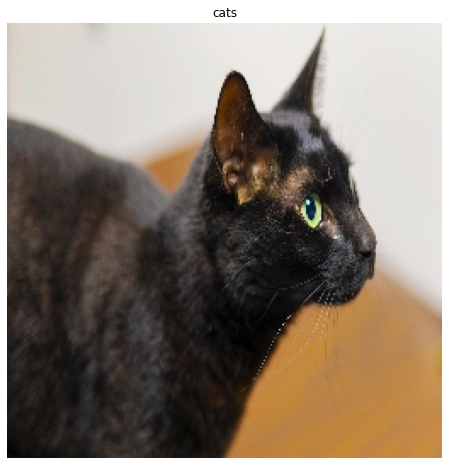

In [13]:
# Select a Random Path
image_path = train_image_paths[np.random.randint(len(train_image_paths))]
label = class_names[int(extract_label(image_path))]

# Get the image
image = load_image(image_path)

# Show the image 
plt.figure(figsize=(8,8))
plt.imshow(image)
plt.title(label)
plt.axis('off')
plt.show()

It's time to **combine these functions** and **load the complete dataset**.

In [14]:
def load_dataset(root_path:str, class_names:list = class_names, BATCH_SIZE:int = 32, shuffle:bool = True, SIZE:tuple = (256, 256), normalize:bool = True):
    
    '''
    This function is build on top of the other functions discussed above to load, and process data. It first collect all the filepaths using the function
    collect_filepaths(), then it creates a NumPy empty array where the images and labels will be stored. After that, it iterates over all the filepaths and
    load the images & extract the labels. Finally, it converts the Image & Label Array into Tensor Flow Data.
    
    Inputs :
        root_path   : The Main directory from which the images are loaded, based on the class names.
        class_names : The name of the classes for this dataset.
        BATCH_SIZE  : The Batch Size of the Output Dataset, this should be kept high(explained below). Default is 32.
        shuffle     : True or False, in case you want the filepaths to be shuffled(this should be done). Default is True.
        SIZE        : The desired size of the image, the default size is 256 x 256 pixels.
        normalize   : The image pixel values are changed from 0-255 to 0-1.
    
    Output :
        data : The Tensorflow Data of the Loaded Images & Labels.
    
    '''
    
    # Collect the filepaths
    filepaths = collect_filepaths(root_path=root_path, class_names=class_names, shuffle=shuffle)
    
    # Create space for the images and labels
    images = np.empty(shape=(len(filepaths), *SIZE, 3), dtype=np.float32)
    labels = np.empty(shape=(len(filepaths), 1), dtype=np.float16)
    
    # Iterate over the file paths
    i = 0
    for path in tqdm(filepaths, desc='Loading'):
        
        # load the Image
        image = load_image(path=path, SIZE=SIZE, normalize=normalize)
        
        # Get the Label
        label = extract_label(path=path, class_names=class_names)
        
        # Send this to the stored space
        images[i] = image
        labels[i] = label
        
        # Increment index
        i+=1
    
    # Convert the images and labels into Tensorflow Data
    data = tfd.Dataset.from_tensor_slices((images, labels))
    data = data.cache().shuffle(1000).repeat(2)
    data = data.batch(BATCH_SIZE, drop_remainder=True)
    data = data.prefetch(tfd.AUTOTUNE)
    
    # Return data 
    return data

**Figuring out My Batch Size**
Here is what AI recommends
---

Generally, use a smaller batch size during training to have faster training because it has been noted that either utilizing a whole data set at once or utilizing multiple mini batches yield similar results. But choose a batch size that fully utilizes the GPU memory as well as provide faster training. 

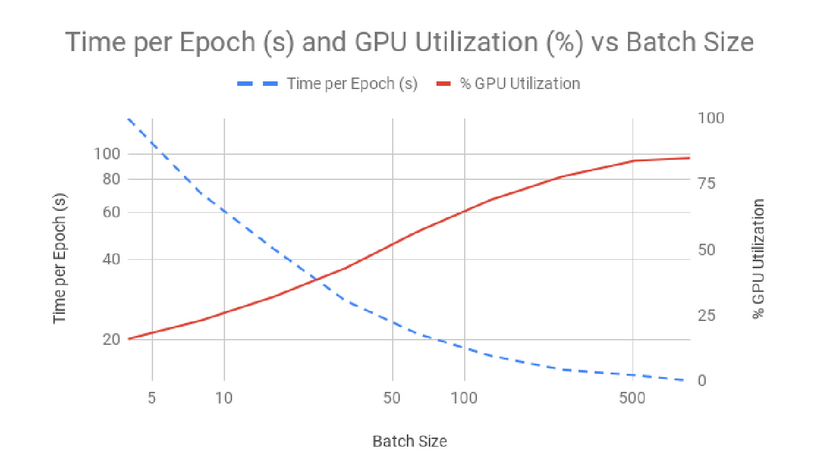

**Normalization**
---

The input values are normalized to :
* Train the first layer faster.
* Avoid network focus on the dimensions with large input.
* Be able to use larger learning rate.

In [15]:
# Load the Training Data
train_ds = load_dataset(
    root_path = train_path,
    class_names = class_names,
    shuffle = True,
    normalize = True,
    BATCH_SIZE = 32,
    SIZE = (256, 256)
)

Loading: 100%|██████████| 557/557 [00:14<00:00, 38.28it/s]


In [16]:
# Load the Testing Data
test_ds = load_dataset(
    root_path = test_path,
    class_names = class_names,
    shuffle = True,
    normalize = True,
    BATCH_SIZE = 32,
    SIZE = (256, 256)
)

Loading: 100%|██████████| 140/140 [00:03<00:00, 42.11it/s]


Training and Testing Data Sets now obtained.

**Data Visualization**

I will plot the images present in the Dataset to understand the Data .

In [17]:
def show_image(image, label:str, show:bool = False) -> None:
    
    '''
    The function plots the given image using Matplotlib.
    
    Input : 
        image : The array of the image to be plotted.
        label : The label of the image to be plotted.
        show  : True or False, Whether to use plt.show() or not.
    '''
    
    # Show the image
    plt.imshow(image)
    
    # Title as the Label
    plt.title(label)
    
    # Clear the axis
    plt.axis('off')
    
    # Show the image is specified
    if show:
        plt.show()

In [18]:
def show_images(data_set, model = None, GRID:list =[8, 4], FIGSIZE:tuple =(20, 40)) -> None:
    
    '''
    This function plots all the images present in the single batch of the given dataset. This function expects that the input dataset has a batch size of 32.
    All the images are shown in a subplot of the GRID size, while the figure size is determined by the FIGSIZE.
    
    Inputs : 
        data_set : The Tensorflow Data set which contains the images and the labels.
        model    : The function to make the predictions.
        GRID     : Specify the number of rows and columns for the subplot.
        FIGSIZE  : The Size of the figure(of matplotlib).
    
    '''
    
    # Plotting Configurations
    N_ROWS, N_COLS = GRID
    plt.figure(figsize=FIGSIZE)

    # Get the Images and Labels
    images, labels = next(iter(data_set))
    
    # Iterate over the Images and Labels
    num = 1
    for image, label in zip(images, labels):
        
        # Make Prediction
        if model is not None:
            proba = model.predict(tf.expand_dims(image, axis=0))
            pred = int(np.round(tf.squeeze(proba)))
            pred_label = class_names[pred]
            title = f"True : {class_names[int(label)]}\nPred : {pred_label}"
        else:
            title = class_names[int(label)]
        
        # Plot the image
        plt.subplot(N_ROWS, N_COLS, num)
        show_image(image, title)
        
        # increment index
        num+=1
    
    # Show the figure
    plt.show()

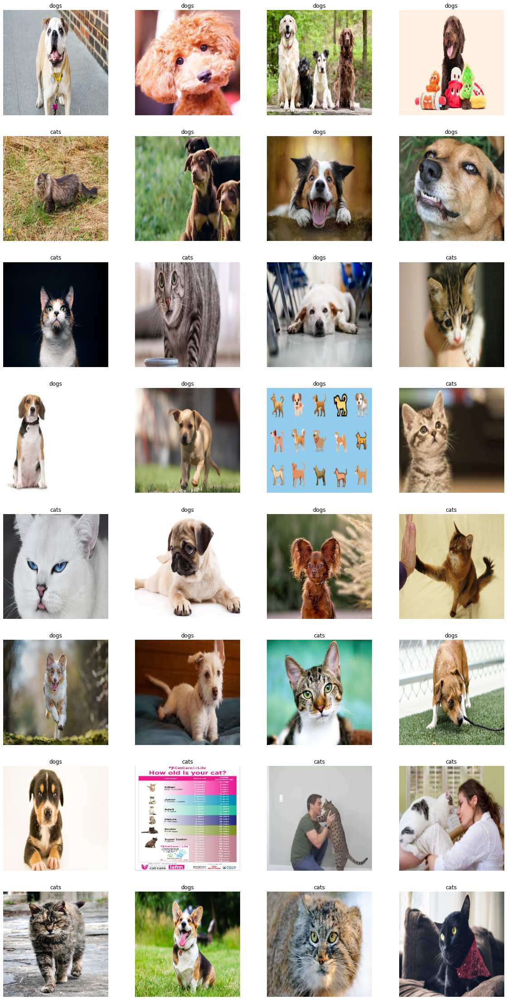

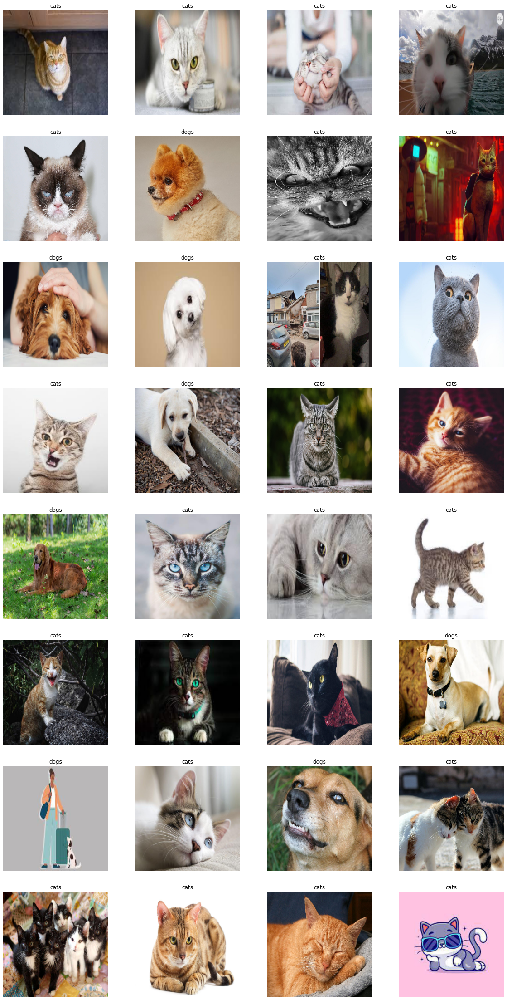

In [19]:
# Let's Visualize the images
show_images(train_ds)
show_images(train_ds)

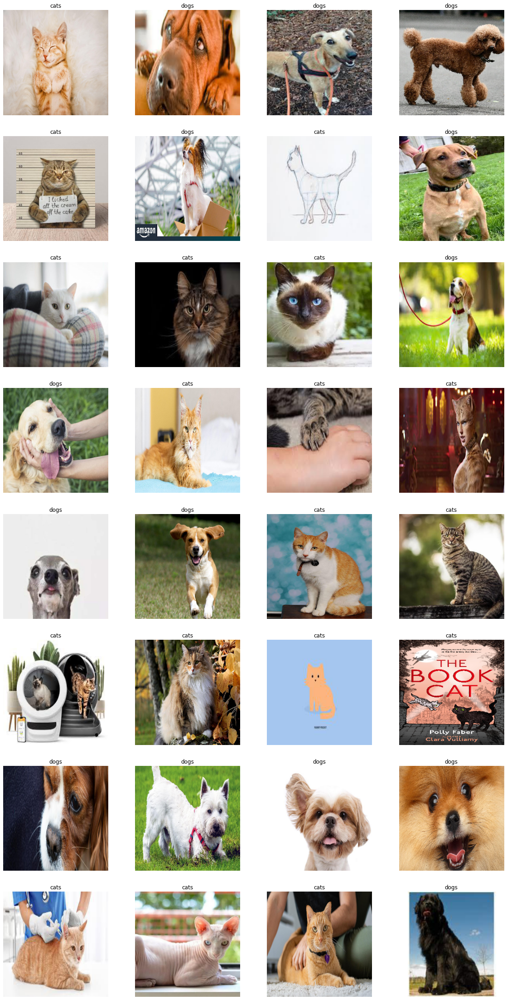

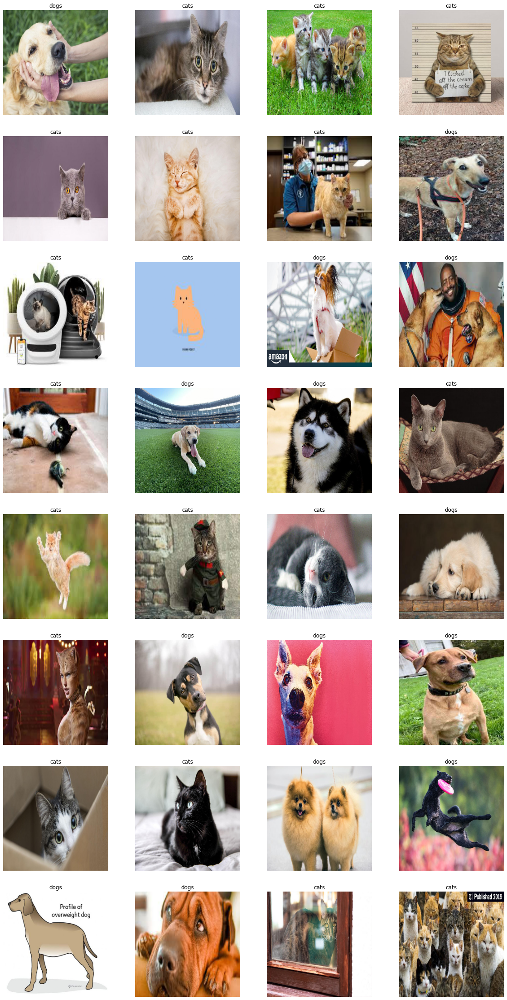

In [20]:
# Let's Visualize the images, once again.
show_images(test_ds)
show_images(test_ds)

**Model Building**
---

build initial models, which backcone is working the best. I plan to take the best backbone and finetune it's parameters to make it even better.

In [21]:
# Constants 
IMAGE_SIZE = (256 , 256, 3)
LEARNING_RATE = 1e-3
DROP_RATE = 0.4
LOG_DIR = "logs/fit/"

In [22]:
def TrainModels(backbones:list, model_names:list, IMAGE_SIZE:tuple = IMAGE_SIZE, LOG_DIR:str = LOG_DIR, DROP_RATE:float = DROP_RATE, LEARNING_RATE:float = LEARNING_RATE) -> None:
    
    '''
    This function is responsible for comparing all the backbones. Our task is to select the top 3 best performing backbones so that we can 
    hyper tune those model architectures and get a robust model. This function does so by training all the backbones one by one on the same 
    set of parameters and model architecture. 
    
    Inputs :
        backbones     : A list of all the backbones which are to be tested.
        model_names   : Special name for each model architecture, using the different backbones to identify each backbone.
        IMAGE_SIZE    : The image size, which is the input size for the model architecture.
        LOG_DIR       : The log directory where all the training logs should be stored.
        DROP_RATE     : The drop rate of the dropout layer used as the last second layer of the model architecture.
        LEARNING_RATE : A fixed learning rate for all the backbones.
    '''
    
    # Performances
    performances = []
    
    # Iterate over all Backbones
    for backbone, model_name in zip(backbones, model_names):
    
        #Show
        print(f"Training Model : {model_name}")
        
        # Model 
        model = Sequential([
            Input(shape=IMAGE_SIZE),
            backbone,
            GAP2D(),
            Dropout(DROP_RATE),
            Dense(1, activation="sigmoid")
        ], name=model_name)

        # Compile
        model.compile(
            loss='binary_crossentropy',
            optimizer=Adam(learning_rate=LEARNING_RATE),
            metrics=['accuracy']
        )

        # Callbacks
        callbacks = [
            EarlyStopping(patience=3, restore_best_weights=True),
            ModelCheckpoint(model_name+".h5", save_best_only=True),
#             TensorBoard(log_dir = LOG_DIR + model_name, histogram_freq=1)
        ]
        
        '''
        I wanted to use tensoboard but for some reason it was not working.
        '''

        # Training
        history = model.fit(
            train_ds,
            validation_data=test_ds,
            epochs=10,
            callbacks = callbacks
        )
        
        # Store Performance
        performances.append(pd.DataFrame(history.history))
        
        # Clear All
        cls()
    
    # Return the Test
    return performances

In [23]:
# Collect all Bacbones 
BACKBONES = [
#     ResNet50(input_shape=IMAGE_SIZE, weights='imagenet', include_top=False),
    ResNet50V2(input_shape=IMAGE_SIZE, weights='imagenet', include_top=False),
#     ResNet152(input_shape=IMAGE_SIZE, weights='imagenet', include_top=False),
#     ResNet152V2(input_shape=IMAGE_SIZE, weights='imagenet', include_top=False),
    InceptionV3(input_shape=IMAGE_SIZE, weights='imagenet', include_top=False),
    Xception(input_shape=IMAGE_SIZE, weights='imagenet', include_top=False),
    MobileNet(input_shape=IMAGE_SIZE, weights='imagenet', include_top=False),
]

# Name all the models
MODEL_NAMES = [
#     "ResNet50",
    "ResNet50V2",
#     "ResNet152",
#     "ResNet152V2",
    "InceptionV3",
    "Xception",
    "MobileNet"
]

# Formating
cls()

In [24]:
# Train all backboes on same architecture
backbone_performances = TrainModels(BACKBONES, MODEL_NAMES)

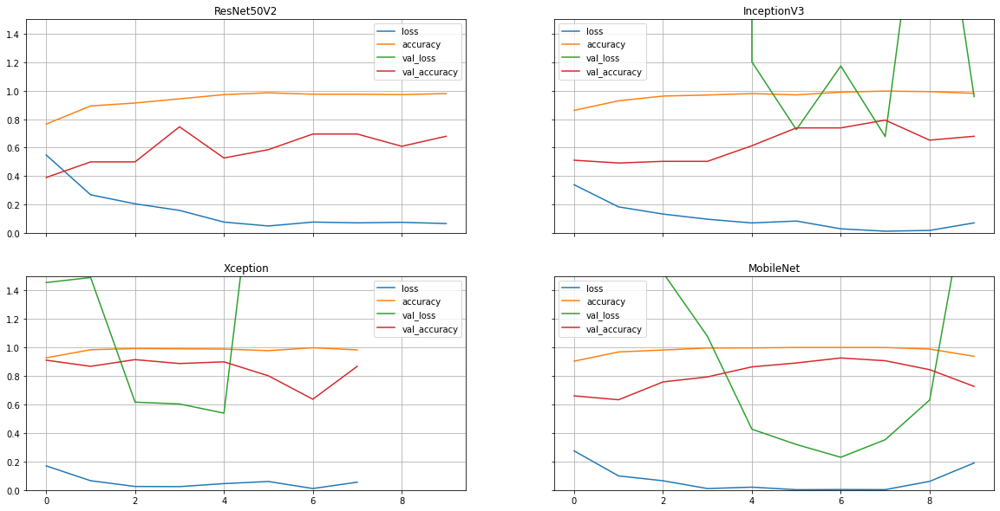

In [33]:
# Let's visualize the Performances
N_ROWS, N_COLS = 2, 2
fig, axs = plt.subplots(N_ROWS, N_COLS, sharex=True, sharey=True)
fig.set_figheight(10)
fig.set_figwidth(20)

# Iterate over the plot
i = 0
for row in range(N_ROWS):
    for col in range(N_COLS):
        backbone_performances[i].plot(ax=axs[row][col])
        axs[row][col].set_title(MODEL_NAMES[i])
        axs[row][col].grid()
        axs[row][col].set_ylim([0,1.5])
        # Stop
        i+=1
        if i>=((N_ROWS*N_COLS)):
            break

# Show final figure
plt.show()

Here I summarize my graph and insights I need to move forward.
* **ResNet50**
  * The model has achieved **100% training accuracy**. Which at first seems to be good.
  * The model has **only 50% validation accuracy**, which means this model is a **guesser**.
  * I see a high gap between the training and validation loss.
  * All these observations shows that the model is **overfitting the data**. 
    

* **ResNet50V2**
  * This model also achieved **100% training accuracy**. 
  * The model have around **76% validation accuracy**, before diverging. Which I like better than the previous model.
  * Observations show  model is better than the ResNet50.

* **ResNet152(V2)**
  * This is the worst model.

* **InceptionV3**
  * The model achieved **99% training accuracy**, close to be, **100% accurate**.
  * The model maintained its validation accuracy to 76%. It is similar to ResNet50V2.
  *  the best performance of the mode was seen at **Epoch 5.

* **Xception**
  * The model has **100% accuracy throughout the training**. 
  * The model has **95% accuracy** at the **peak of its performance**.
  * This model has the lowest training to validation loss. But diverges towards the end of the training.
    * This **will be hyper tuned**.

* **MobileNet**
  * This model also maintains its **100% accuracy throughout training**.
  * This model has **95% of accuracy** at the **peak of its performance**.
  * This model has the **3rd lowest** difference between training and validation loss.
    * The **2nd best model**, so I will **hyper tune this**.
    

# **Xception Hypertunning**

A hyperparameter search is the process of finding the best hyperparameters by training models with different values of hyperparameters and evaluating their performance.

In [26]:
def build_model_Xc(hp):
    
    # Select the BACKBONE
    BACKBONE = Xception(include_top=False, input_shape=IMAGE_SIZE, weights='imagenet')
    
    # Model 
    model = Sequential([
        Input(shape=IMAGE_SIZE),
        BACKBONE,
        GAP2D(),
    ])
    
    # Dynamic Architecture
    for l in range(hp.Choice("Num_layers",[1, 3, 5])): # Number of Top Layers
        
        # Use Batch Normalization or not
        if hp.Choice("use_BN", [True, False]): 
            model.add(BatchNormalization())
        
        # Add Dropout layer
        model.add(Dropout(rate = hp.Choice("Drop_rate", [0.2,0.4])))
        
        # Dense Layer
        model.add(Dense(units = hp.Choice("hidden_units",[100, 200, 300]), activation='relu', kernel_initializer='he_normal'))
    
    # Final layer
    model.add(Dense(1, activation='sigmoid'))
    
    # Compile
    model.compile(
        loss='binary_crossentropy',
        optimizer=Adam(learning_rate=hp.Choice("lr",[1e-3, 1e-5])),
        metrics=['accuracy']
    )
    
    # Return Model
    return model

# Give the Search a Name
name = "Xception_Search"

# Initialize Hyperband
tuner = Hyperband(build_model_Xc, objective='val_loss', max_epochs=20, project_name=name)

# Search
tuner.search(train_ds, validation_data=test_ds)

Trial 30 Complete [00h 05m 37s]
val_loss: 0.11042404174804688

Best val_loss So Far: 0.08290863037109375
Total elapsed time: 01h 08m 36s


In [27]:
# Best Model 
best_xception = tuner.get_best_models()[0]

In [29]:
# Let's have a look at the best model architecture.
best_xception.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
xception (Functional)        (None, 8, 8, 2048)        20861480  
_________________________________________________________________
global_average_pooling2d (Gl (None, 2048)              0         
_________________________________________________________________
dropout (Dropout)            (None, 2048)              0         
_________________________________________________________________
dense (Dense)                (None, 200)               409800    
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 201       
Total params: 21,271,481
Trainable params: 21,216,953
Non-trainable params: 54,528
_________________________________________________________________


I was **expected by me**, the best model **does not have too many layers** included on **top of the backbone**.

# **MobileNet Hypertunning**

In [28]:
def build_model_MN(hp):
    
    # Select the BACKBONE
    BACKBONE = MobileNet(include_top=False, input_shape=IMAGE_SIZE, weights='imagenet')
    
    # Model 
    model = Sequential([
        Input(shape=IMAGE_SIZE),
        BACKBONE,
        GAP2D(),
    ])
    
    # Dynamic Architecture
    for l in range(hp.Choice("Num_layers",[1, 2, 5])): # Number of Top Layers
        
        # Use Batch Normalization or not
        if hp.Choice("use_BN", [True, False]): 
            model.add(BatchNormalization())
        
        # Add Dropout layer
        model.add(Dropout(rate = hp.Choice("Drop_rate", [0.2,0.4])))
        
        # Dense Layer
        model.add(Dense(units = hp.Choice("hidden_units",[10,100,200]), activation='relu', kernel_initializer='he_normal'))
    
    # Final layer
    model.add(Dense(1, activation='sigmoid'))
    
    # Compile
    model.compile(
        loss='binary_crossentropy',
        optimizer=Adam(learning_rate=hp.Choice("lr",[1e-3, 1e-5])),
        metrics=['accuracy']
    )
    
    # Return Model
    return model

# Give the Search a Name
name = "MobileNet_Search"

# Initialize Hyperband
tuner = Hyperband(build_model_MN, objective='val_loss', max_epochs=20, project_name=name)

# Search
tuner.search(train_ds, validation_data=test_ds)

Trial 30 Complete [00h 01m 41s]
val_loss: 0.2681102752685547

Best val_loss So Far: 0.11270904541015625
Total elapsed time: 00h 21m 16s


In [30]:
# Get the best model
best_mobilenet = tuner.get_best_models()[0]

# Have a look at model architecture
best_mobilenet.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenet_1.00_224 (Function (None, 8, 8, 1024)        3228864   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1024)              0         
_________________________________________________________________
dropout (Dropout)            (None, 1024)              0         
_________________________________________________________________
dense (Dense)                (None, 200)               205000    
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 201       
Total params: 3,434,065
Trainable params: 3,412,177
Non-trainable params: 21,888
_________________________________________________________________


# **Model Evaluation**

top 2 models. 

In [31]:
best_xception.evaluate(test_ds)

8/8 [==============================] - 2s 91ms/step - loss: 0.0817 - accuracy: 0.9609


[0.08167648315429688, 0.9609375]

In [32]:
best_mobilenet.evaluate(test_ds)

8/8 [==============================] - 1s 29ms/step - loss: 0.1145 - accuracy: 0.9453


[0.11445999145507812, 0.9453125]

`Xception` is the best, both in terms of accuracy and loss. It has the lowest loss and highest accuracy.

# **Model Predictions**

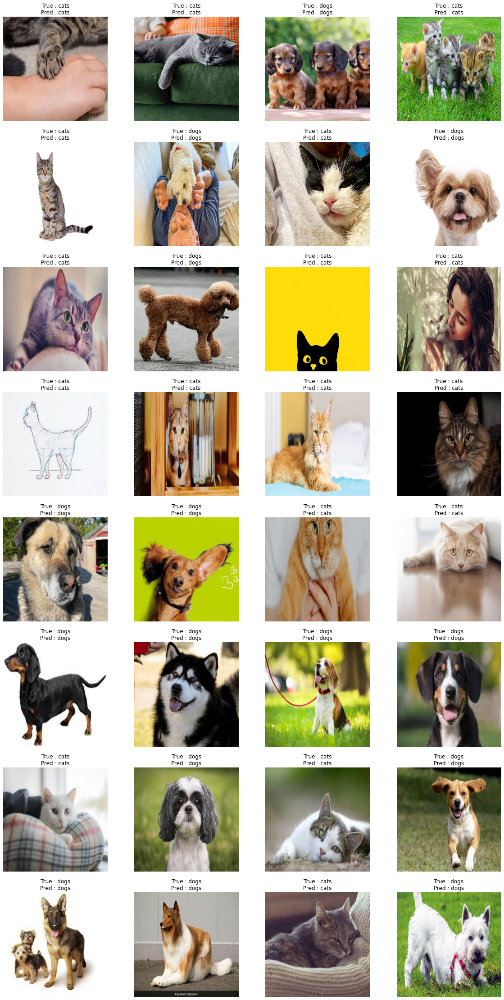

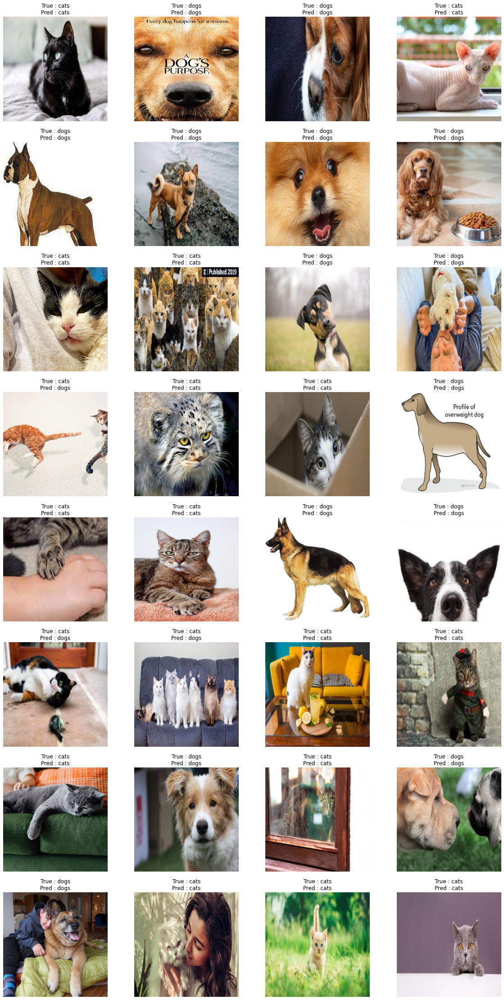

In [35]:
# Let's see this intuitively
show_images(test_ds, model=best_xception)
show_images(test_ds, model=best_xception)

# **Conclusion**

In conclusion, this visual project focused on classifying cats and dogs, pre-trained models were employed, e.g ResNet50, Xception. 
 Initially, the models were used as feature extractors with their pre-trained weights, yielding decent performance. However, after fine-tuning the models by unfreezing the top layers and applying data augmentation techniques the accuracy significantly improved. 
The fine-tuned models were better able to generalize and differentiate between the two classes without being a 50% chance, 
showcasing the effectiveness of transfer learning and data augmentation in enhancing model performance for image classification tasks.